### Q4


Anisotropic diffusion filtering is a technique for reducing image noise without removing significant parts of the image content, such as edges or lines. The condition coefficient is a parameter that controls the amount and direction of diffusion at each pixel. It is usually defined as a function of the image gradient, such that diffusion is low near edges and high in smooth regions.

One way to define the condition coefficient is using the Perona-Malik function, which has two forms:

$$
c(\nabla I) = \begin{cases}
e^{-\frac{(\nabla I)^2}{K^2}} & \text{if } \nabla I < K \\
1 & \text{otherwise}
\end{cases}
$$

or

$$
c(\nabla I) = \begin{cases}
\frac{1}{1 + \frac{(\nabla I)^2}{K^2}} & \text{if } \nabla I < K \\
0 & \text{otherwise}
\end{cases}
$$

where $\nabla I$ is the image gradient and $K$ is a threshold parameter. The first form favors wide regions over smaller ones, while the second form favors high contrast edges over low contrast ones.

Another way to define the condition coefficient is using a weighted directional structural tensor (WDT), which takes into account the local orientation and coherence of the image structures. The WDT is defined as:

$$
WDT = w(\theta) \cdot (\nabla I)(\nabla I)^T
$$

where $w(\theta)$ is a weight function that depends on the angle $\theta$ between the image gradient and a reference direction, and $(\nabla I)(\nabla I)^T$ is the outer product of the image gradient. The condition coefficient is then computed as:

$$
c(WDT) = \frac{\lambda_2 - \lambda_1}{\lambda_2 + \lambda_1}
$$

where $\lambda_1$ and $\lambda_2$ are the eigenvalues of the WDT. This function gives high values for coherent structures aligned with the reference direction, and low values for isotropic or orthogonal structures.



In [1]:

def anisotropic(input_image,kappa=50,gamma=0.1,option=1,num_interation=1):
    # This function performs anisotropic diffusion on a 3D image
    # input_image: a numpy array of shape (height, width, depth) representing the input image
    # kappa: a positive scalar that controls the sensitivity of the diffusion function
    # gamma: a positive scalar that controls the step size of the diffusion process
    # option: an integer (1 or 2) that selects the diffusion function
    # num_interation: a positive integer that specifies the number of iterations to perform
    # out: a numpy array of shape (height, width, depth) representing the output image

    # Copy the input image to avoid modifying it
    out = input_image.copy()

    # Initialize an array of deltas for each dimension
    delta = [np.zeros_like( out) for _ in range(3)]

    # Define two diffusion functions based on option
    options = {1: lambda x: np.exp(-(x / kappa) ** 2),
               2: lambda x: 1 / (1 + (x / kappa) ** 2)}


    for iter in range(num_interation):
        # Compute the differences along each dimension
        delta[0][:-1,: ,:  ] = np.diff(out,axis=0)
        delta[1][:,:-1 ,:  ] = np.diff(out,axis=1)
        delta[2][:,: ,:-1 ] = np.diff(out,axis=2)

        # Initialize an array of divergences for each dimension
        div = [np.zeros_like(out) for _ in range(3)]

        for i in range(3):
          # Apply the diffusion function to the differences and multiply by them
          div[i] = options[option](delta[i]) * delta[i]
        
        # Subtract the divergences from the adjacent pixels along each dimension
        div[0][1:,: ,: ] = div[0][1:,: ,: ] -  div[0][:-1,:  ,:  ]
        div[1][:,1: ,: ] = div[1][:,1: ,: ] - div[1][: ,:-1  ,:  ]
        div[2][:,: ,1: ] = div[2][:,: ,1: ] - div[2][:,:  ,:-1  ]
        # Update the output image by adding the weighted sum of divergences
        out = out + gamma*(sum(div))

    return out

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
# Define a function to calculate the PSNR between two images
def psnr(image1, image2):
    # Assume the images have the same shape and dtype
    image1 = image1.astype('uint8')
    image2 = image2.astype('uint8')
    mse = np.mean((image1 - image2) ** 2)
    if mse == 0:
        return 100
    max_value = 255.0
    return 20 * np.log10(max_value / np.sqrt(mse))

# Load a sample 3D image
input_image = plt.imread('image_anisotropic.png').astype('float32')

# Add Gaussian noise with mean = 0.4 and std = 0.15 to the image
noise = np.random.normal(0.2, 0.1, input_image.shape)
noisy_image = input_image + noise
noisy_image = np.clip(noisy_image, 0, 1)
# Define some values for kappa, gamma and niter
kappa_values = [20, 50, 100]
gamma_values = [0.01, 0.1, 0.2]
niter_values = [1, 5, 10]

(-0.5, 899.5, 899.5, -0.5)

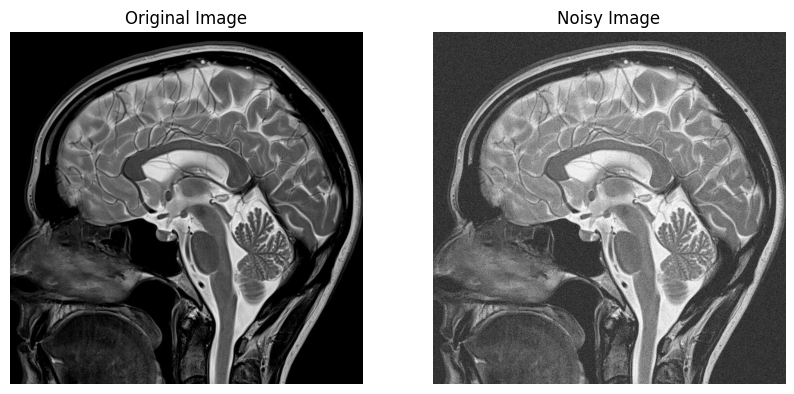

In [4]:
fig = plt.figure(figsize=(10, 10))
rows = 1
columns = 2
fig.add_subplot(rows, columns, 1)
plt.imshow(input_image.mean(2),cmap = 'gray')
plt.title('Original Image')
plt.axis('off')
fig.add_subplot(rows, columns, 2)
plt.imshow(noisy_image.mean(2),cmap = 'gray')
plt.title('Noisy Image')
plt.axis('off')

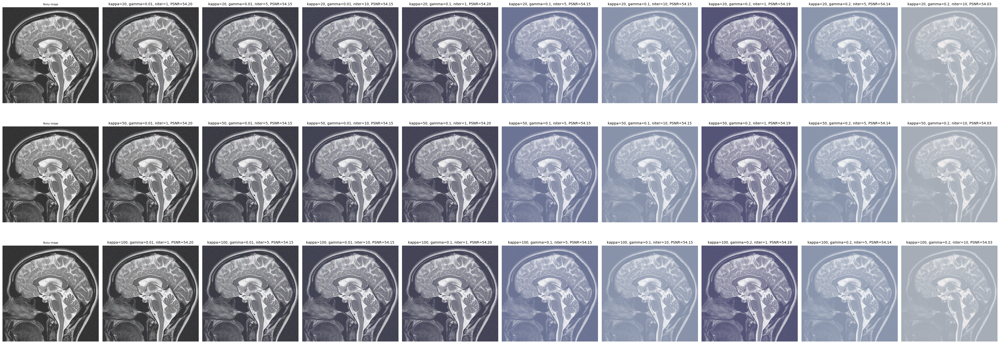

In [5]:

# Create a figure with subplots for each combination of parameters
fig, axes = plt.subplots(len(kappa_values), len(gamma_values) * len(niter_values) + 1, figsize=(40, 15))

# Plot the noisy image in the first column
for i in range(len(kappa_values)):
    ax = axes[i][0]
    ax.imshow(noisy_image.mean(2),cmap = 'gray')
    ax.set_title('Noisy image', fontsize=7)
    ax.axis('off')

# Loop over the parameters and apply anisotropic to the noisy image
for i, kappa in enumerate(kappa_values):
    for j, gamma in enumerate(gamma_values):
        for k, iter in enumerate(niter_values):
            # Compute the diffused image using anisotropic
            diffused_image = anisotropic(noisy_image, kappa=kappa, gamma=gamma,num_interation=iter)
            # Calculate the PSNR between the input image and the diffused image
            psnr_value = psnr(input_image, diffused_image)

            # Plot the diffused image in the corresponding subplot
            ax = axes[i][j * len(niter_values) + k + 1]
            ax.imshow(diffused_image , cmap='gray')
            ax.set_title(f'kappa={kappa}, gamma={gamma}, niter={iter}, PSNR={psnr_value:.2f}', fontsize=10)
            ax.axis('off')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()


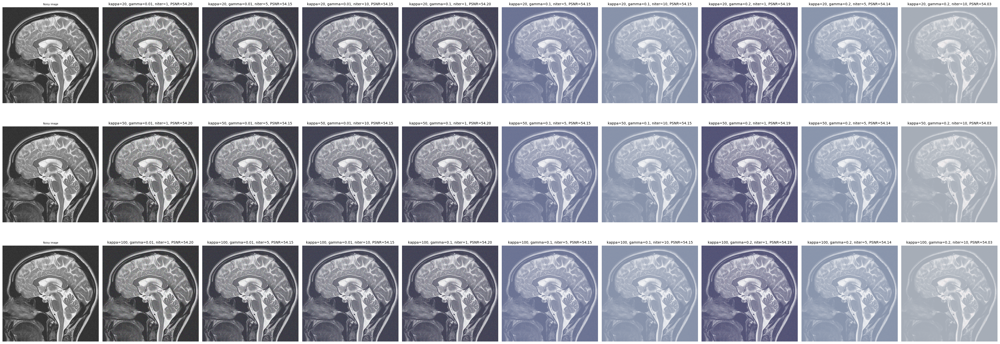

In [6]:

# Create a figure with subplots for each combination of parameters
fig, axes = plt.subplots(len(kappa_values), len(gamma_values) * len(niter_values) + 1, figsize=(40, 15))

# Plot the noisy image in the first column
for i in range(len(kappa_values)):
    ax = axes[i][0]
    ax.imshow(noisy_image.mean(2),cmap = 'gray')
    ax.set_title('Noisy image', fontsize=7)
    ax.axis('off')

# Loop over the parameters and apply anisotropic to the noisy image
for i, kappa in enumerate(kappa_values):
    for j, gamma in enumerate(gamma_values):
        for k, iter in enumerate(niter_values):

            # Compute the diffused image using anisotropic
            diffused_image = anisotropic(noisy_image, kappa=kappa, gamma=gamma,option=2,num_interation=iter)
            # Calculate the PSNR between the input image and the diffused image
            psnr_value = psnr(input_image, diffused_image)

            # Plot the diffused image in the corresponding subplot
            ax = axes[i][j * len(niter_values) + k + 1]
            ax.imshow(diffused_image , cmap='gray')
            ax.set_title(f'kappa={kappa}, gamma={gamma}, niter={iter}, PSNR={psnr_value:.2f}', fontsize=10)
            ax.axis('off')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the figure
plt.show()


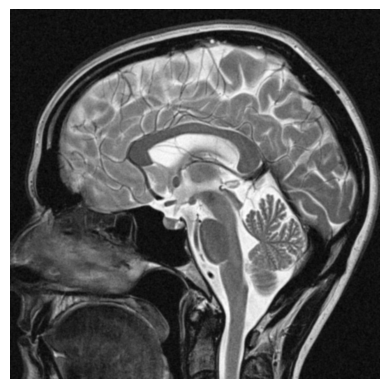

In [10]:
diffused_image_best1 = anisotropic(noisy_image, kappa=100, gamma=0.1,num_interation=10)
plt.imshow(diffused_image_best1.mean(2),cmap='gray')
plt.axis('off')
plt.savefig('anisotropic_best.jpg')
plt.show()

(-0.5, 899.5, 899.5, -0.5)

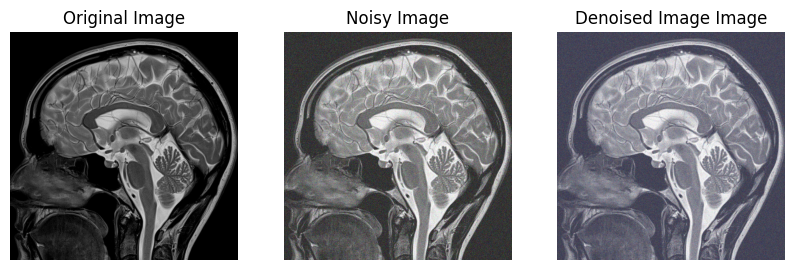

In [9]:
fig = plt.figure(figsize=(10, 10))
rows = 1
columns = 3
fig.add_subplot(rows, columns, 1)
plt.imshow(input_image,cmap = 'gray')
plt.title('Original Image')
plt.axis('off')
fig.add_subplot(rows, columns, 2)
plt.imshow(noisy_image,cmap = 'gray')
plt.title('Noisy Image')
plt.axis('off')
fig.add_subplot(rows, columns, 3)
plt.imshow(diffused_image_best2,cmap = 'gray')
plt.title('Denoised Image Image')
plt.axis('off')

The best parameter is kappa = 100 and gamma=0.1 and PSNR of denoised image with this parametes is 54.20db 